# Imports

In [1]:
import pandas as pd
import numpy as np
import plotly.express as px

In [2]:
crime= pd.read_csv("Data/crime_cleaned.csv", index_col=0)

# 6. Multivariate analysis 

## 6.1 Shooting/Area

I will look at the data on shooting and area to see wheter there are more shootings in a particular area

In [3]:
Shootings = crime[crime.SHOOTING==1]

In [4]:
Shootings_per_area = Shootings[["REPORTING_AREA", "SHOOTING"]].groupby("REPORTING_AREA").sum()
Shootings_per_area = Shootings_per_area.sort_values(by="SHOOTING", ascending= False)
Shootings_per_area[Shootings_per_area.values > 10]

,SHOOTING
REPORTING_AREA,
0,29
238,18
326,18
912,17
329,17
427,16
332,16
909,16
911,15


Here we can see the the areas where there were the most shootings

## 6.2 Shooting/District

In [86]:
Shootings_per_district = Shootings[["DISTRICT", "SHOOTING"]].groupby("DISTRICT").sum()
Shootings_per_district = Shootings_per_district.sort_values(by="SHOOTING", ascending= False)
Shootings_per_district[Shootings_per_district.values > 10]

,SHOOTING
DISTRICT,
B2,344
B3,221
C11,187
E13,65
D4,56
C6,41
E18,34
D14,20
E5,19


Here we can see that the B districts deal with the most shooting

## 6.3 UCR_PART/ District

In [255]:
UCR_per_district = pd.DataFrame(Shootings[["UCR_PART", "DISTRICT"]].value_counts().groupby(["DISTRICT", "UCR_PART"]).sum())
District_count = Shootings.DISTRICT.value_counts()

In [202]:
x = UCR_per_district.unstack(0)

for col in x[0].columns:
    x[(0, col)] = (x[(0, col)].values) / (x[(0,col)].sum())

X  = pd.DataFrame(x.T.stack())

In [254]:
fig = px.bar(y = X[0].values, x=X.unstack(0).index.get_level_values(0), text=X[0].values, color=X.unstack(0).index.get_level_values(1), labels={"color":"UCR"})
fig.update_layout(title_text = " UCR proportion per district", title_x = 0.45, yaxis_title = '%',xaxis_title="District")
fig.update_traces(texttemplate='%{text:.2%}', textposition='inside')

Here we can see that proportions of each UCR part that the districts have to deal with. We can that the most common UCR is one but some district have more Part 2 and part 3 than others

# Time Series Analysis

In this section I will predict the number of crimes that there will be in 2019

In [ ]:
crime_per_date = pd.DataFrame(index = pd.to_datetime(crime.OCCURRED_ON_DATE.value_counts().index),data= crime.OCCURRED_ON_DATE.value_counts().values, columns=["y"])
# I will regroup the data per day
crime_per_date = crime_per_date.groupby(pd.Grouper(freq='D')).sum()
crime_per_date["ds"]=  crime_per_date.index
crime_per_date.head()

In [ ]:
#Visualizing
px.line(crime_per_date, x='ds', y='y')


## Building the model

In [ ]:
from prophet import Prophet
from prophet.plot import plot_plotly, plot_components

In [ ]:
model = Prophet()
model.add_country_holidays(country_name='US')
model.fit(crime_per_date)

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


In [ ]:
future_df = model.make_future_dataframe(360)
forecast=  model.predict(future_df)

In [ ]:
plot_plotly(model, forecast)

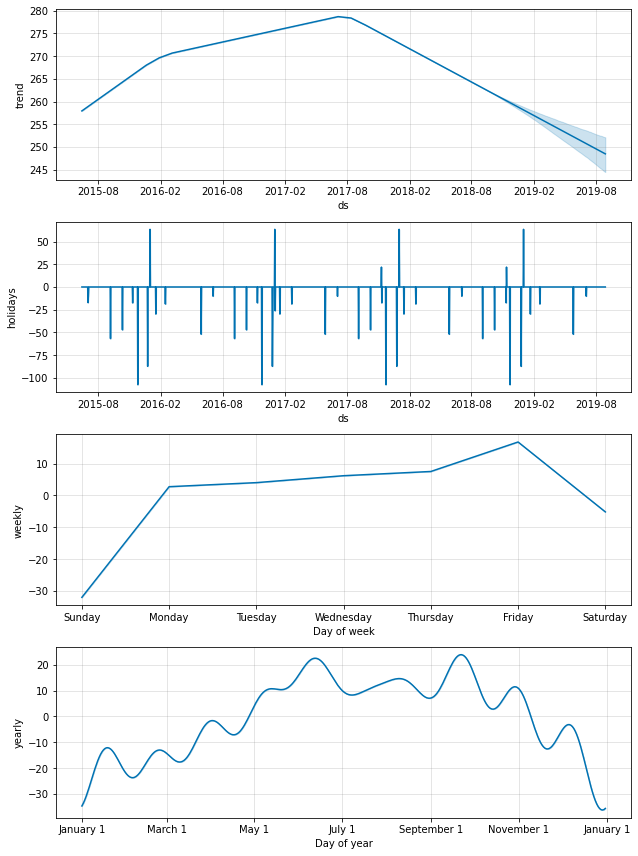

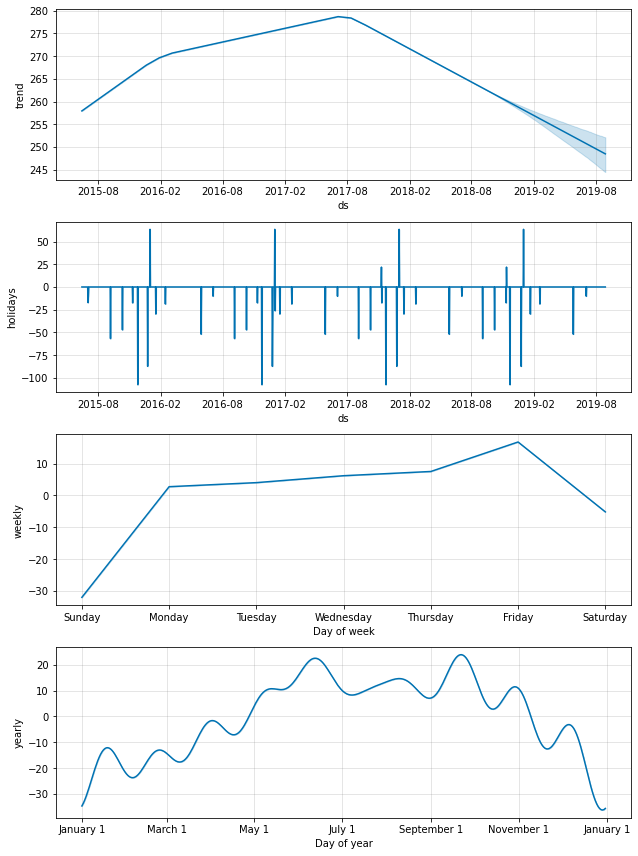

In [ ]:
plot_components(model, forecast)

With this model, the police can look at crime trends and seaosonality as well as predictng the number of crimes that there will be in 2019

# 5.1 Predicting the district

In this part I will use a KNeighbors Classifier model that predicts which district was appointed to the crime base an its location ( Long and Lat)

In [2]:
Geolocdata = pd.read_csv("Data/Geolocadata.csv", index_col=0)

In [3]:
Geolocdata[["Lat", "Long"]].describe()

,Lat,Long
count,317308.000000,317308.000000
mean,42.293609,-71.036437
std,0.976291,1.578827
min,-1.000000,-71.178674
25%,42.290983,-71.095308
50%,42.321230,-71.075678
75%,42.347310,-71.060094
max,42.395042,-1.000000


In [4]:
#Removing outliers
outliers = Geolocdata.loc[((Geolocdata.Lat>(42.5))|(Geolocdata.Lat<(42.21438)))|((Geolocdata.Long>(-70.965))|(Geolocdata.Long<(-72)))].index
Geolocdata.drop(outliers, inplace=True)

 Scaling the data

In [5]:
# As we still have outliers I will scale the data with the Minmaxscaler
from sklearn.preprocessing import StandardScaler
scaler= StandardScaler()

In [6]:
scaled_loca = pd.DataFrame(scaler.fit_transform(Geolocdata[["Long", "Lat"]]))

Making the model

In [7]:
#imports
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split

In [8]:
# Separating the target from the rest of the Data
X,y  = scaled_loca[[0, 1]], Geolocdata["DISTRICT"].copy()
# Seprating the data into training and testing datasets
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.25, random_state=42)

In [9]:
knn = KNeighborsClassifier(n_neighbors=y.nunique())
knn.fit(X_train, y_train)

KNeighborsClassifier(n_neighbors=12)

In [10]:
knn.fit(X_train, y_train)

KNeighborsClassifier(n_neighbors=12)

In [11]:
print(knn.score(X_test, y_test),knn.score(X_train, y_train))

0.9796118724531652 0.9807281089877214


Both my train and test scores look verry good 

We can now find the Null values of the district column using our model

In [13]:
#Getting the indexes of the district NA's
District_NA_indexes = list(crime[crime.DISTRICT.isnull() == True].index)

In [14]:
#I will have to drop the indexes of the rows where Lat and long are missing because I will not be able to predict the district for these rows
Lat_Long_NA_indx =  list(crime[crime.Lat.isnull() == True].index)

for indx in Lat_Long_NA_indx:
    if indx in District_NA_indexes:
        District_NA_indexes.remove(indx)
    

In [15]:
#Let's find the values of Lat and long for the missing values of District
Lat_Long_for_pred = crime.iloc[District_NA_indexes][["Lat", "Long"]]

In [16]:
#Preddicting the Na's
Na_preds = knn.predict(Lat_Long_for_pred)

#Replacing the missing values
crime.loc[District_NA_indexes,"DISTRICT"] = Na_preds

# Clustering the Geolocalisations

I will use Kmeans to cluster the geolocalisations, the first step is to define the number of clusters that are needed, for that I will the elbow and the Silouhette methods

In [17]:
from sklearn.cluster import KMeans
from sklearn import metrics

In [18]:
distortions = []

K = range(1,15)

for cluster_size in K:
    kmeans = KMeans(n_clusters=cluster_size, init='k-means++')
    kmeans = kmeans.fit(scaled_loca)
    distortions.append(kmeans.inertia_)
    
df = pd.DataFrame({'Clusters': K, 'Distortions': distortions})
fig = (px.line(df, x='Clusters', y='Distortions', template='seaborn')).update_traces(mode='lines+markers')
fig.show()


Here we can see that all the data fit in only two clusters

In [19]:
silhouette_scores = []
K = range(2,12)

for cluster_size in K:
    kmeans = KMeans(n_clusters=cluster_size, init='k-means++', random_state=200)
    labels = kmeans.fit(scaled_loca).labels_
    silhouette_score = metrics.silhouette_score(scaled_loca, 
                                                labels, 
                                                metric='euclidean',
                                                sample_size=1000,  
                                                random_state=200)
    
    silhouette_scores.append(silhouette_score)

df = pd.DataFrame({'Clusters': K, 'Silhouette Score': silhouette_scores})
fig = (px.line(df, x='Clusters', y='Silhouette Score', template='seaborn')).update_traces(mode='lines+markers')
fig.show()

The optimal number of clusters seem to 5

In [20]:
model= KMeans(n_clusters=5)
model.fit(scaled_loca)

KMeans(n_clusters=5)

In [21]:
model.cluster_centers_

array([[ 0.35496969, -0.77024216],
       [-1.43199705, -1.56236236],
       [ 0.99016915,  1.09553116],
       [-2.02217209,  0.8854351 ],
       [-0.14829883,  0.2891032 ]])

In [22]:
clusters = model.labels_

fig = px.scatter(scaled_loca, x=0, y=1, color= clusters, hover_data=[0, 1], template='ggplot2')

fig.update_layout(template = 'plotly_white')
fig.update_layout(
    autosize=False,
    width=800,
    height=800,)
fig

The police could use these clusters to organise their central departments departments. as their are currently 12 district, let's try and do the same opartion but with 12 clusters

In [23]:
model2 = KMeans(n_clusters=12)
model2.fit(scaled_loca)

KMeans(n_clusters=12)

In [ ]:
clusters = model2.labels_

fig = px.scatter(scaled_loca, x=0, y=1, color= clusters, hover_data=[0, 1], template='ggplot2')

fig.update_layout(template = 'plotly_white')
fig.update_layout(
    autosize=False,
    width=800,
    height=800,)

These cluster centers represent the optimal location for each district

# Predicting UCR_PART with offense code

In this part I will use k neirest neighbours again to predict the missing UCR part of our data. Each offense code belongs to an offense part thus it should be possible to predict the ucr part with this variable alone

In [25]:
data_needed = crime[["OFFENSE_CODE", "UCR_PART"]].copy()
data_needed.dropna(inplace=True)

In [26]:
X_train, X_test, y_train, y_test = train_test_split(data_needed["OFFENSE_CODE"], data_needed["UCR_PART"], test_size=0.25)
X_train= np.array(X_train).reshape(-1,1)
y_train= np.array(y_train).reshape(-1,1)
X_test = np.array(X_test).reshape(-1,1)
y_test = np.array(y_test).reshape(-1,1)


In [27]:
Classifier = KNeighborsClassifier(n_neighbors=3)
Classifier.fit(X_train, y_train)
print(f"Train score: {Classifier.score(X_train, y_train)}\nTest score: {Classifier.score(X_test, y_test)}")

C:\Users\Luky-\Anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:179: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



Train score: 0.9999958200445583
Test score: 0.9999749203721817


As expected the scores are nearly 1, because offense code is a perfect predictor of UCR_part

In [28]:
#Getting the indexes of the UCR_part NA's
UCR_NA_indexes = list(crime[crime.UCR_PART.isnull() == True].index)

In [29]:
#Making sure that the OFFENSE code does not have any Na's or strange values
print(crime.OFFENSE_CODE.isna().any())

crime.OFFENSE_CODE.describe()

False


count    319073.000000
mean       2317.546956
std        1185.285543
min         111.000000
25%        1001.000000
50%        2907.000000
75%        3201.000000
max        3831.000000
Name: OFFENSE_CODE, dtype: float64

Everything seems normal

In [30]:
#Let's find the values of Lat and long for the missing values of District
offense_code_for_pred = crime.iloc[UCR_NA_indexes][["OFFENSE_CODE"]]

In [31]:
#Preddicting the Na's
Na_UCR_preds = Classifier.predict(offense_code_for_pred)

#Replacing the missing values
crime.loc[UCR_NA_indexes,"UCR_PART"] = Na_UCR_preds

In [32]:
crime.loc[UCR_NA_indexes,"UCR_PART"]

1252        Part Two
9214        Part Two
11592       Part Two
19577       Part Two
22316       Part Two
             ...    
241806      Part Two
255412      Part Two
318753    Part Three
318994    Part Three
319039    Part Three
Name: UCR_PART, Length: 90, dtype: object

# Cosine similarities of the crimes

In this part I will try and identify the most similar crimes, Because if crimes have similar locations, type, and date, the crimes may have been commited by the same person/persons. My first step will be to drop the incident number duplicates as we already know taht these offenses were commited by the same person. then I will select the variables that are relevent and encod them into integers when needed.

In [33]:
#Selecting the needed variables
crime.columns

Index(['INCIDENT_NUMBER', 'OFFENSE_CODE', 'OFFENSE_CODE_GROUP',
       'OFFENSE_DESCRIPTION', 'DISTRICT', 'REPORTING_AREA', 'SHOOTING',
       'OCCURRED_ON_DATE', 'YEAR', 'MONTH', 'DAY_OF_WEEK', 'HOUR', 'UCR_PART',
       'STREET', 'Lat', 'Long', 'Location'],
      dtype='object')

In [34]:
# I will take the Incident incindent numbers to drop the duplicates
df =pd.DataFrame(crime["INCIDENT_NUMBER"])
df.drop_duplicates(subset="INCIDENT_NUMBER", inplace =True)

In [35]:
#for the type of offense I will use offense_code group, as it is a good compromise between ucr part and offense_code
df = pd.DataFrame(crime["OFFENSE_CODE_GROUP"])
df["OFFENSE_CODE_GROUP"].nunique()
#I will have to one hot encode this column

67

In [36]:
# Generate dummies functions
def generate_dummies(dataframe, column_name):
    _dummy_dataset = pd.get_dummies(dataframe[column_name], prefix=column_name)
    dataframe = pd.concat([dataframe, _dummy_dataset], axis=1)
    return dataframe.drop(column_name, axis=1)

In [37]:
df = generate_dummies(df, "OFFENSE_CODE_GROUP")

In [38]:
# For the time variable I will use Year month, day_of_the_week and I will encode a new variable day which will be the days of the month. The hour variable is not important here as one can not really commit several crimes
df["Year"] = crime["YEAR"]
df["Month"]= crime["MONTH"]
df["Week_day"] = crime["DAY_OF_WEEK"]
df["day"] = pd.to_datetime(crime.OCCURRED_ON_DATE).dt.day



In [39]:
# I also need to label encode the weekday column
from sklearn.preprocessing import LabelEncoder

In [40]:
LE = LabelEncoder()
df["Week_day"] = LE.fit_transform(df["Week_day"])

In [41]:
# For the location I will choose the street as lat and long don't have a lot of meanin individually
df["Street"] = crime["STREET"]
# I will need to one hot encod this variable, because there are a lot of streets I will only take the 500 most frequents which accounts for 75% of the data
df = df[df["Street"].isin(df.Street.value_counts(normalize=True)[:500].index)]

In [42]:
df =generate_dummies(df, "Street")

In [43]:
df

,OFFENSE_CODE_GROUP_Aggravated Assault,OFFENSE_CODE_GROUP_Aircraft,OFFENSE_CODE_GROUP_Arson,OFFENSE_CODE_GROUP_Assembly or Gathering Violations,OFFENSE_CODE_GROUP_Auto Theft,OFFENSE_CODE_GROUP_Auto Theft Recovery,OFFENSE_CODE_GROUP_Ballistics,OFFENSE_CODE_GROUP_Biological Threat,OFFENSE_CODE_GROUP_Bomb Hoax,OFFENSE_CODE_GROUP_Burglary - No Property Taken,...,Street_WILMINGTON AVE,Street_WINTER ST,Street_WINTHROP ST,Street_WOOD AVE,Street_WOODBOLE AVE,Street_WOODROW AVE,Street_WOOLSON ST,Street_WORCESTER ST,Street_YAWKEY WAY,Street_ZEIGLER ST
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
12,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
319066,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
319067,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
319069,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
319070,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


## PCA

Because I have so many columns I will perform a PCA to reduce the number of dimensions

In [44]:
from sklearn.decomposition import PCA

In [45]:
PCA = PCA(n_components=0.95)
PCA.fit(df)

PCA(n_components=0.95)

In [46]:
PCA.n_components_

3

95% of the variance is captured by only 3 PCA vectors

In [263]:
pca_sample = pd.DataFrame(PCA.transform(df))

# Cosine similarity

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity

In [ ]:
pca_norm = pca_sample.apply(lambda x: (x - np.mean(x))/(np.max(x) - np.min(x)), axis = 1)

case_similarity = pd.DataFrame(cosine_similarity(pca_norm[pca_norm.index<100].astype(np.float32)), columns=crime.loc[crime.index<100, "INCIDENT_NUMBER"], index=crime.loc[crime.index<100, "INCIDENT_NUMBER"])

In [ ]:
case_similarity

INCIDENT_NUMBER,I182070945,I182070943,I182070941,I182070940,I182070938,I182070936,I182070933,I182070932,I182070931,I182070929,...,I182070834,I182070833,I182070833,I182070832,I182070831,I182070830,I182070829,I182070829,I182070828,I182070827
INCIDENT_NUMBER,,,,,,,,,,,,,,,,,,,,,
I182070945,1.000000,0.978926,0.966010,0.950569,0.933586,0.915824,0.897778,0.879812,0.862241,0.845358,...,0.512070,0.491985,0.509847,0.490186,0.422519,0.488457,0.487600,0.486769,0.485959,0.485166
I182070943,0.978926,1.000000,0.997816,0.992036,0.983688,0.973607,0.962414,0.950559,0.938438,0.926384,...,0.648025,0.631890,0.646075,0.630271,0.565682,0.628715,0.627944,0.627196,0.626465,0.625751
I182070941,0.966010,0.997816,1.000000,0.998189,0.993422,0.986557,0.978253,0.968997,0.959208,0.949236,...,0.696909,0.681708,0.695073,0.680180,0.618891,0.678711,0.677982,0.677276,0.676585,0.675911
I182070940,0.950569,0.992036,0.998189,1.000000,0.998511,0.994601,0.988958,0.982104,0.974476,0.966439,...,0.738774,0.724482,0.737049,0.723042,0.664989,0.721658,0.720971,0.720305,0.719654,0.719018
I182070938,0.933586,0.983688,0.993422,0.998511,1.000000,0.998780,0.995569,0.990915,0.985270,0.979013,...,0.774424,0.761002,0.772804,0.759647,0.704709,0.758343,0.757696,0.757069,0.756456,0.755856
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
I182070830,0.488457,0.628715,0.678711,0.721658,0.758343,0.789601,0.816279,0.839120,0.858643,0.875274,...,0.999541,0.999992,0.999608,0.999998,0.996554,1.000000,0.999999,0.999998,0.999996,0.999993
I182070829,0.487600,0.627944,0.677982,0.720971,0.757696,0.788992,0.815705,0.838580,0.858134,0.874794,...,0.999515,0.999987,0.999585,0.999995,0.996631,0.999999,1.000000,1.000000,0.999998,0.999996
I182070829,0.486769,0.627196,0.677276,0.720305,0.757069,0.788402,0.815150,0.838057,0.857640,0.874329,...,0.999489,0.999982,0.999562,0.999992,0.996705,0.999998,1.000000,1.000000,1.000000,0.999998


case_similarity

Note that I will select the first 100 rows because I don't have enough computational power to do the rest 

In [ ]:
for col in range(0,100):
  for indx in range(0,100):
    if(col!=indx):
      if case_similarity.iloc[indx,col]>0.98:
        print(f"Cases {case_similarity.index[indx]} and {case_similarity.columns[col]} are {np.round(case_similarity.iloc[indx,col]*100, 2)}% similar")


CasesI182070941 and I182070943 are 99.78% similar
CasesI182070940 and I182070943 are 99.2% similar
CasesI182070938 and I182070943 are 98.37% similar
CasesI182070943 and I182070941 are 99.78% similar
CasesI182070940 and I182070941 are 99.82% similar
CasesI182070938 and I182070941 are 99.34% similar
CasesI182070936 and I182070941 are 98.66% similar
CasesI182070943 and I182070940 are 99.2% similar
CasesI182070941 and I182070940 are 99.82% similar
CasesI182070938 and I182070940 are 99.85% similar
CasesI182070936 and I182070940 are 99.46% similar
CasesI182070933 and I182070940 are 98.9% similar
CasesI182070932 and I182070940 are 98.21% similar
CasesI182070943 and I182070938 are 98.37% similar
CasesI182070941 and I182070938 are 99.34% similar
CasesI182070940 and I182070938 are 99.85% similar
CasesI182070936 and I182070938 are 99.88% similar
CasesI182070933 and I182070938 are 99.56% similar
CasesI182070932 and I182070938 are 99.09% similar
CasesI182070931 and I182070938 are 98.53% similar
Cas

Now that know what cases are very similar, the police could group this cases as they might have been commited by the same individual(s)